I wanted to compare the gradient term of robust training and nonrobust training.
So I have fixed epsilon to 0.2 in the doublebackTrainer and compute the loss term in every training.

# Plotting level sets

The goal is to plot the level set evolution for the neural ODEs with standard and robust training

In [2]:
import torch
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

import matplotlib.pyplot as plt
import numpy as np



# Juptyer magic: For export. Makes the plots size right for the screen 
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

# %config InlineBackend.figure_formats = ['svg'] 


torch.backends.cudnn.deterministic = True
torch.manual_seed(2)
torch.cuda.manual_seed(2)

g = torch.Generator()
g.manual_seed(1)


# Data preparation

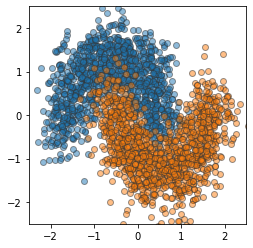

In [1]:
from sklearn.model_selection import train_test_split
from sklearn.datasets import make_moons, make_circles, make_blobs
from sklearn.preprocessing import StandardScaler

from torch.utils import data as data
from torch.utils.data import DataLoader, TensorDataset

from models.training import create_dataloader

data_noise = 0.25
dataloader, dataloader_viz = create_dataloader('moons', noise = data_noise, plotlim = [-2.5,2.5])



#Visualizing the data


In [3]:
#We can now conveniently access the data from the dataloaders
for X_test, y_test in dataloader_viz:
    print(X_test[:10], y_test[:10])
    break
    

tensor([[ 0.1788,  1.7109],
        [ 0.2918, -0.0559],
        [-0.6637,  1.4374],
        [ 0.0168, -0.7785],
        [ 0.2291, -0.9217],
        [ 0.4315,  0.0938],
        [-1.0653,  0.5882],
        [ 0.2291,  0.0942],
        [ 1.9412, -0.1800],
        [-0.4573, -0.1293]]) tensor([0, 0, 0, 1, 1, 0, 0, 0, 1, 1])


# Model dynamics

In [4]:
#Import of the model dynamics that describe the neural ODE
#The dynamics are based on the torchdiffeq package, that implements ODE solvers in the pytorch setting
from models.neural_odes import NeuralODE

#for neural ODE based networks the network width is constant. In this example the input is 2 dimensional
hidden_dim, data_dim = 2, 2 
augment_dim = 0

#T is the end time of the neural ODE evolution, num_steps are the amount of discretization steps for the ODE solver
T, num_steps = 10, 11 
bound = 0.
fp = False #this recent change made things not work anymore
cross_entropy = True
turnpike = False


non_linearity = 'tanh' #'relu' #
architecture = 'inside' #outside



torch.manual_seed(2)
torch.cuda.manual_seed(2)
anode = NeuralODE(device, data_dim, hidden_dim, augment_dim=augment_dim, non_linearity=non_linearity, 
                    architecture=architecture, T=T, time_steps=num_steps, fixed_projector=fp, cross_entropy=cross_entropy)
optimizer_anode = torch.optim.Adam(anode.parameters(), lr=1e-3) 


print(anode)

    


NeuralODE(
  (flow): Semiflow(
    (dynamics): Dynamics(
      (non_linearity): Tanh()
      (fc2_time): Sequential(
        (0): Linear(in_features=2, out_features=2, bias=True)
        (1): Linear(in_features=2, out_features=2, bias=True)
        (2): Linear(in_features=2, out_features=2, bias=True)
        (3): Linear(in_features=2, out_features=2, bias=True)
        (4): Linear(in_features=2, out_features=2, bias=True)
        (5): Linear(in_features=2, out_features=2, bias=True)
        (6): Linear(in_features=2, out_features=2, bias=True)
        (7): Linear(in_features=2, out_features=2, bias=True)
        (8): Linear(in_features=2, out_features=2, bias=True)
        (9): Linear(in_features=2, out_features=2, bias=True)
        (10): Linear(in_features=2, out_features=2, bias=True)
      )
    )
  )
  (linear_layer): Linear(in_features=2, out_features=2, bias=True)
  (non_linearity): Tanh()
)


In [5]:
torch.manual_seed(2)
torch.cuda.manual_seed(2)
rnode = NeuralODE(device, data_dim, hidden_dim, augment_dim=0, non_linearity=non_linearity, 
                    architecture=architecture, T=T, time_steps=num_steps, fixed_projector=fp, cross_entropy=cross_entropy)
optimizer_rnode = torch.optim.Adam(rnode.parameters(), lr=1e-3) 


print(rnode)

NeuralODE(
  (flow): Semiflow(
    (dynamics): Dynamics(
      (non_linearity): Tanh()
      (fc2_time): Sequential(
        (0): Linear(in_features=2, out_features=2, bias=True)
        (1): Linear(in_features=2, out_features=2, bias=True)
        (2): Linear(in_features=2, out_features=2, bias=True)
        (3): Linear(in_features=2, out_features=2, bias=True)
        (4): Linear(in_features=2, out_features=2, bias=True)
        (5): Linear(in_features=2, out_features=2, bias=True)
        (6): Linear(in_features=2, out_features=2, bias=True)
        (7): Linear(in_features=2, out_features=2, bias=True)
        (8): Linear(in_features=2, out_features=2, bias=True)
        (9): Linear(in_features=2, out_features=2, bias=True)
        (10): Linear(in_features=2, out_features=2, bias=True)
      )
    )
  )
  (linear_layer): Linear(in_features=2, out_features=2, bias=True)
  (non_linearity): Tanh()
)


## Training

In [6]:
from models.training import Trainer, doublebackTrainer

num_epochs = 50 #number of optimization runs in which the dataset is used for gradient decent
rob_eps = 0.3 #Set robust training parameter in order to compare standard training to robuts training (and logging the gradient term in both cases)


trainer_anode = doublebackTrainer(anode, optimizer_anode, device, cross_entropy=cross_entropy, turnpike = turnpike,
                         bound=bound, fixed_projector=fp, verbose = True, eps = 0, eps_comp = rob_eps) 

trainer_anode.train(dataloader, num_epochs)

0.3

Iteration 0/45
Loss: 1.241
Robust Term Loss: 0.300
Accuracy: 0.094

Iteration 10/45
Loss: 1.132
Robust Term Loss: 0.251
Accuracy: 0.109

Iteration 20/45
Loss: 0.963
Robust Term Loss: 0.196
Accuracy: 0.172

Iteration 30/45
Loss: 1.007
Robust Term Loss: 0.195
Accuracy: 0.156

Iteration 40/45
Loss: 0.840
Robust Term Loss: 0.138
Accuracy: 0.156
Epoch 1: 1.014
0.3

Iteration 0/45
Loss: 0.888
Robust Term Loss: 0.157
Accuracy: 0.125

Iteration 10/45
Loss: 0.879
Robust Term Loss: 0.160
Accuracy: 0.234

Iteration 20/45
Loss: 0.816
Robust Term Loss: 0.128
Accuracy: 0.219

Iteration 30/45
Loss: 0.831
Robust Term Loss: 0.145
Accuracy: 0.312

Iteration 40/45
Loss: 0.739
Robust Term Loss: 0.107
Accuracy: 0.438
Epoch 2: 0.819
0.3

Iteration 0/45
Loss: 0.759
Robust Term Loss: 0.121
Accuracy: 0.469

Iteration 10/45
Loss: 0.774
Robust Term Loss: 0.133
Accuracy: 0.406

Iteration 20/45
Loss: 0.744
Robust Term Loss: 0.108
Accuracy: 0.438

Iteration 30/45
Loss: 0.731
Robust Term Loss: 0.124
Accuracy: 0

In [7]:
   
w = anode.linear_layer.weight
b = anode.linear_layer.bias

print(w)
print(b)

rnode.linear_layer.weight = w
rnode.linear_layer.bias = b

rnode.linear_layer.requires_grad =  False

Parameter containing:
tensor([[-0.1109, -1.1510],
        [ 0.1201,  0.8325]], requires_grad=True)
Parameter containing:
tensor([-0.4937,  0.4655], requires_grad=True)


In [8]:
from models.training import doublebackTrainer

# num_epochs = 120 #number of optimization runs in which the dataset is used for gradient decent
trainer_rnode = doublebackTrainer(rnode, optimizer_rnode, device, cross_entropy=cross_entropy, turnpike = turnpike,
                         bound=bound, fixed_projector=fp, verbose = True, eps = rob_eps) 

trainer_rnode.train(dataloader, num_epochs)

0.3

Iteration 0/45
Loss: 1.505
Robust Term Loss: 0.549
Accuracy: 0.281

Iteration 10/45
Loss: 1.417
Robust Term Loss: 0.513
Accuracy: 0.266

Iteration 20/45
Loss: 1.097
Robust Term Loss: 0.390
Accuracy: 0.359

Iteration 30/45
Loss: 1.143
Robust Term Loss: 0.395
Accuracy: 0.375

Iteration 40/45
Loss: 0.859
Robust Term Loss: 0.271
Accuracy: 0.531
Epoch 1: 1.162
0.3

Iteration 0/45
Loss: 0.938
Robust Term Loss: 0.312
Accuracy: 0.391

Iteration 10/45
Loss: 0.951
Robust Term Loss: 0.329
Accuracy: 0.422

Iteration 20/45
Loss: 0.798
Robust Term Loss: 0.255
Accuracy: 0.375

Iteration 30/45
Loss: 0.804
Robust Term Loss: 0.273
Accuracy: 0.547

Iteration 40/45
Loss: 0.644
Robust Term Loss: 0.188
Accuracy: 0.609
Epoch 2: 0.800
0.3

Iteration 0/45
Loss: 0.652
Robust Term Loss: 0.208
Accuracy: 0.594

Iteration 10/45
Loss: 0.683
Robust Term Loss: 0.219
Accuracy: 0.562

Iteration 20/45
Loss: 0.636
Robust Term Loss: 0.181
Accuracy: 0.500

Iteration 30/45
Loss: 0.603
Robust Term Loss: 0.198
Accuracy: 0

In [9]:
   
w = anode.linear_layer.weight
b = anode.linear_layer.bias

print(w)
print(b)

wr = rnode.linear_layer.weight
br = rnode.linear_layer.bias

print(wr)
print(b)

Parameter containing:
tensor([[-0.1109, -1.1510],
        [ 0.1201,  0.8325]], requires_grad=True)
Parameter containing:
tensor([-0.4937,  0.4655], requires_grad=True)
Parameter containing:
tensor([[-0.1109, -1.1510],
        [ 0.1201,  0.8325]], requires_grad=True)
Parameter containing:
tensor([-0.4937,  0.4655], requires_grad=True)


# Plotting Level Sets

Observe that the blue and red data points are getting seperated further as time passes.

In [10]:
import seaborn as sns
from matplotlib.colors import to_rgba, to_rgb
import numpy as np
import torch.nn as nn

import matplotlib
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap

from plots.plots import classification_levelsets, comparison_plot


In [11]:
import imageio
import os
fig_name_base = 'levelsets'
fig_name = fig_name_base + '.png'
gif_name = fig_name_base + '_comp.gif'

fig_name_base_rob = fig_name_base + '_rob'
fig_name_rob = fig_name_base_rob + '.png'


for X_viz, y_viz in dataloader_viz:
    imgs = []
    for layer in torch.arange(num_steps):
        classification_levelsets(anode, fig_name = fig_name_base, layer = layer)
        # imgs.append(imageio.imread(fig_name))
        classification_levelsets(rnode, fig_name = fig_name_base_rob, layer = layer)
        
        comparison_plot(fig_name, 'standard training', fig_name_rob, 'robust training', 'levelsets_comp.png')
        print(layer, ' plotted')
        
        # plt.figure(dpi = 600)
        # plt.subplot(121)
        # levelsets = imageio.imread(fig_name)
        # plt.imshow(levelsets)
        # plt.title('Standard Training')
        # plt.axis('off')

        # plt.subplot(122)
        # levelsets_rob = imageio.imread(fig_name_rob)
        # plt.imshow(levelsets_rob)
        # plt.title('Robust Training')
        # plt.axis('off')
        # plt.savefig('levelsets_comp.png', bbox_inches='tight', dpi=300, format='png', facecolor = 'white')
        # plt.clf()
        # plt.close()
        
        imgs.append(imageio.imread('levelsets_comp.png'))
        # if not (num_steps == layer + 1): os.remove(fig_name_rob) #keep last image
    imageio.mimwrite(gif_name, imgs, fps = 1)
    # visualize_classification(rnode, X_viz, y_viz, fig_name = 'class_test1')
    break

TypeError: classification_levelsets() got multiple values for argument 'fig_name'

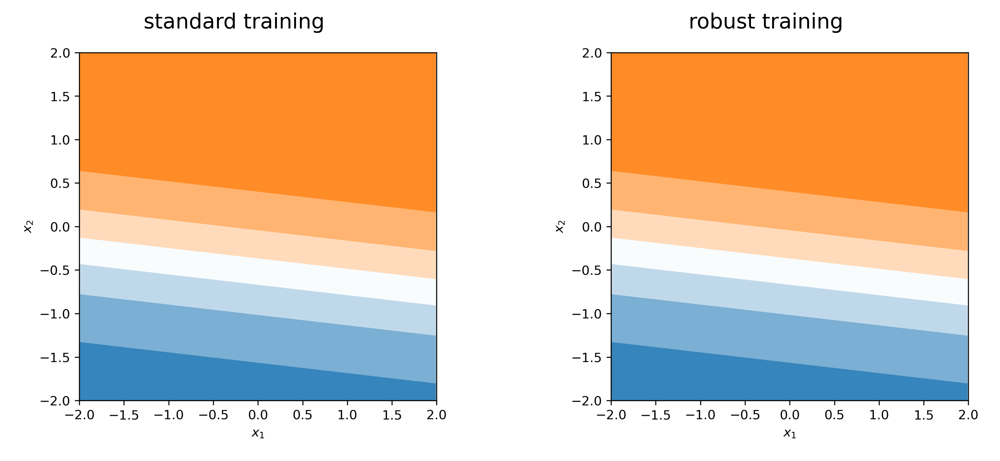

In [ ]:
from IPython.display import Image
Image(filename="levelsets_comp.gif",  width = 800)

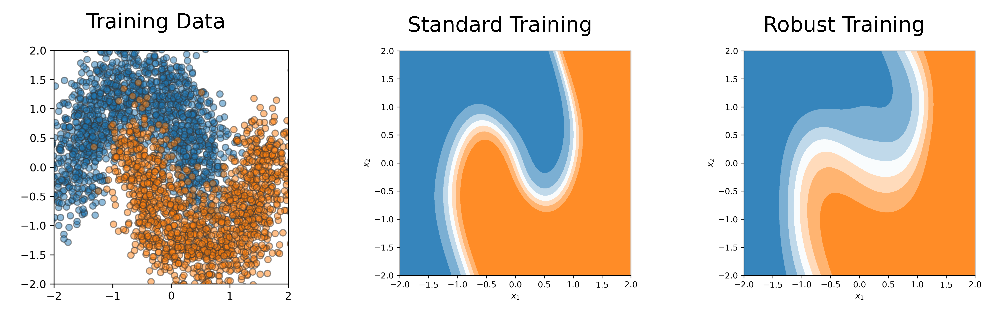

In [14]:
import imageio

plt.figure(dpi = 600, figsize = (10,30))

plt.subplot(131)
levelsets_rob = imageio.imread('trainingset.png')
plt.imshow(levelsets_rob)
plt.title('Training Data')
plt.axis('off')

plt.subplot(132)
levelsets = imageio.imread('levelsets.png')
plt.imshow(levelsets)
plt.title('Standard Training')
plt.axis('off')

plt.subplot(133)
levelsets_rob = imageio.imread('levelsets_rob.png')
plt.imshow(levelsets_rob)
plt.title('Robust Training')
plt.axis('off')

plt.savefig('levelset_comp.png', bbox_inches='tight', dpi=600, format='png', facecolor = 'white')
plt.show()

## Loss

KeyError: 'epoch_loss_rob_history'

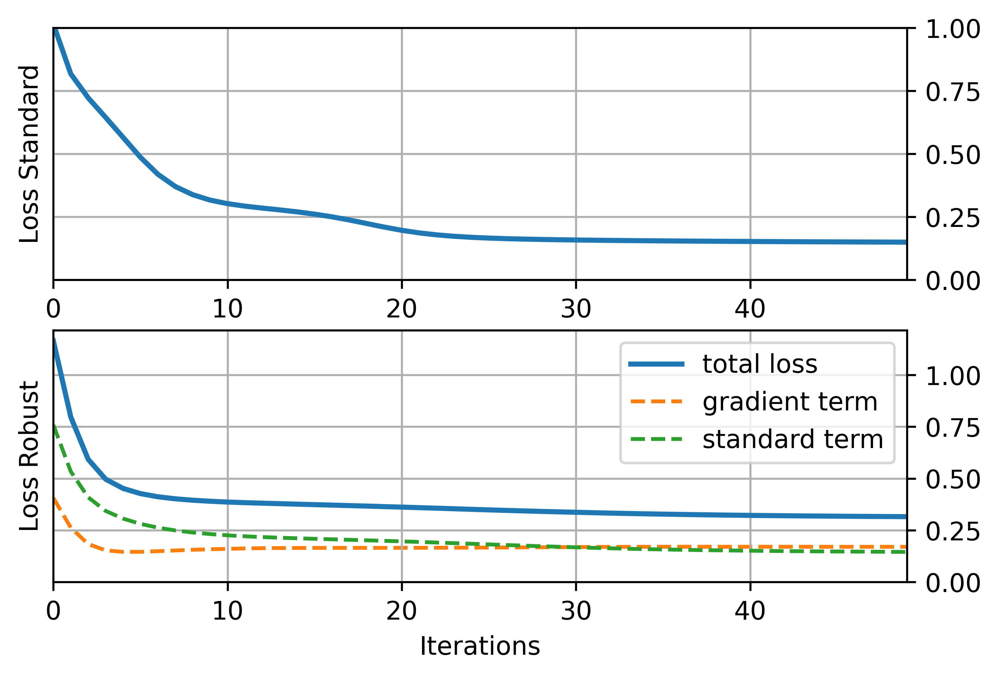

In [15]:
plt.figure(dpi = 300)
labelsize = 10

plt.subplot(211)
plt.plot(trainer_anode.histories['epoch_loss_history'], linewidth = 2)
# plt.plot(trainer_anode.histories['epoch_loss_rob_history'], zorder = -1, linewidth = 1)
plt.xlim(0, len(trainer_anode.histories['epoch_loss_history']) - 1)
plt.ylim([0,1])

plt.yticks(np.arange(0,1.25,0.25))
plt.grid()
ax = plt.gca()
ax.yaxis.tick_right()
# ax.set_aspect()
plt.ylabel('Loss Standard', size = labelsize)

plt.subplot(212)
plt.plot(trainer_rnode.histories['epoch_loss_history'], linewidth = 2)
plt.plot(trainer_rnode.histories['epoch_loss_rob_history'], '--', zorder = -1)
plt.plot([loss - rob for loss, rob in zip(trainer_rnode.histories['epoch_loss_history'],trainer_rnode.histories['epoch_loss_rob_history'])],'--')
plt.xlim(0, len(trainer_rnode.histories['epoch_loss_history']) - 1)
plt.ylim(0)
plt.xlabel('Iterations', size = labelsize)
plt.ylabel('Loss Robust', size = labelsize)
plt.legend(['total loss', 'gradient term', 'standard term'], prop= {'size': labelsize})
plt.yticks(np.arange(0,1.25,0.25))
ax = plt.gca()
ax.yaxis.tick_right()
plt.grid()

plt.savefig('loss_comp.png', bbox_inches='tight', dpi=300, format='png', facecolor = 'white')
plt.show()
# plt.clf()
# plt.close()




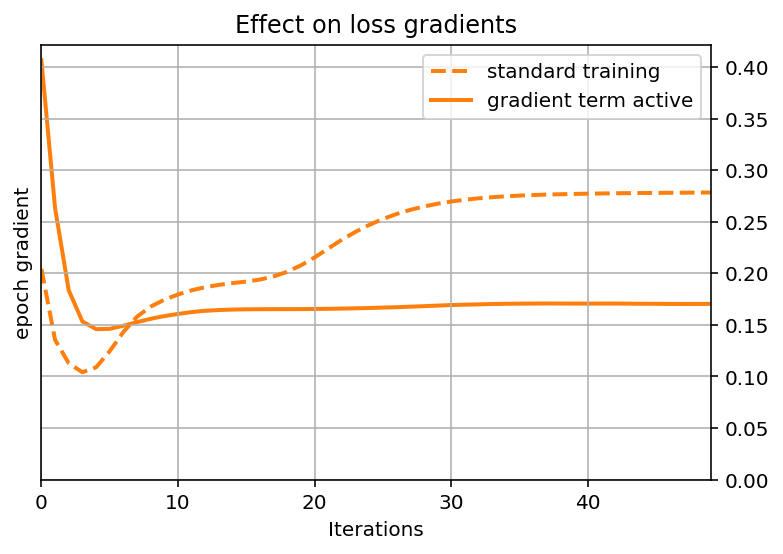

In [16]:
plt.plot(trainer_anode.histories['epoch_loss_rob_history'],'--', linewidth = 2, color = 'C1')
plt.title('Effect on loss gradients')
plt.plot(trainer_rnode.histories['epoch_loss_rob_history'], zorder = -1, linewidth = 2, color = 'C1')
plt.xlim(0, len(trainer_rnode.histories['epoch_loss_history']) - 1)
plt.ylim(0)
plt.xlabel('Iterations', size = labelsize)
plt.ylabel('epoch gradient', size = labelsize)
plt.legend(['standard training', 'gradient term active'], prop= {'size': labelsize})
# plt.yticks(np.arange(0,1.25,0.25))
ax = plt.gca()
ax.yaxis.tick_right()
plt.grid()

plt.savefig('loss_comp_grads.png', bbox_inches='tight', dpi=300, format='png', facecolor = 'white')
plt.show()


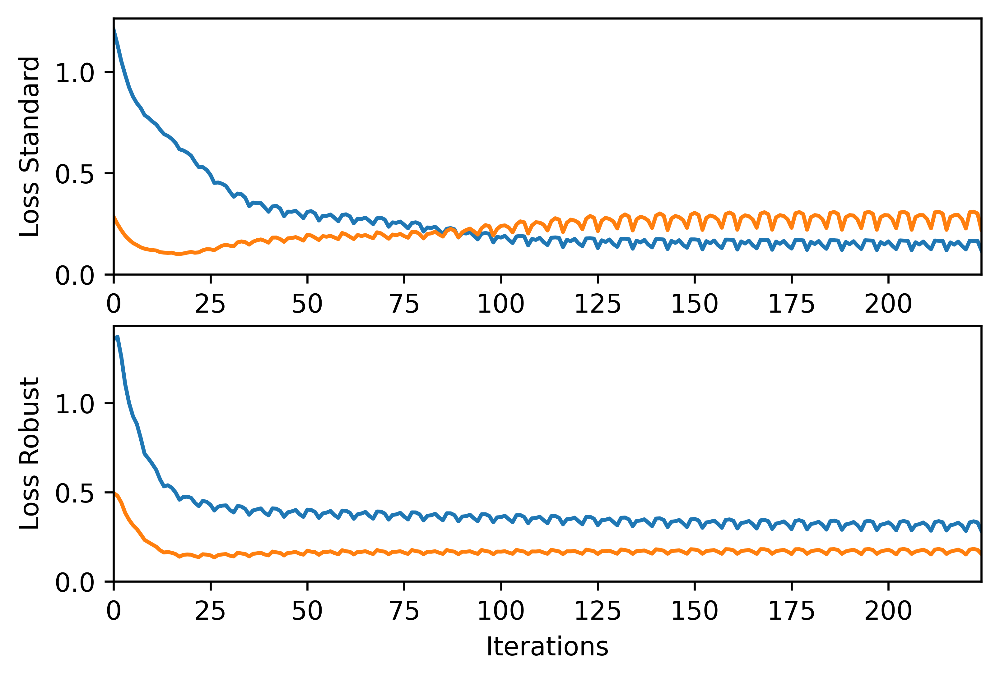

In [17]:
plt.figure(dpi = 300)
plt.subplot(211)
plt.plot(trainer_anode.histories['loss_history'])
plt.plot(trainer_anode.histories['loss_rob_history'])
plt.xlim(0, len(trainer_anode.histories['loss_history']) - 1)
plt.ylim(0)
plt.xlabel('Iterations')
plt.ylabel('Loss Standard')

plt.subplot(212)
plt.plot(trainer_rnode.histories['loss_history'])
plt.plot(trainer_rnode.histories['loss_rob_history'], zorder = -1)
# plt.plot([loss - rob for loss, rob in zip(trainer_rnode.histories['epoch_loss_history'],trainer_rnode.histories['epoch_loss_rob_history'])])
plt.xlim(0, len(trainer_rnode.histories['loss_history']) - 1)
plt.ylim(0)
plt.xlabel('Iterations')
plt.ylabel('Loss Robust')
plt.savefig('loss_comp.png', bbox_inches='tight', dpi=600, format='png', facecolor = 'white')
plt.show()

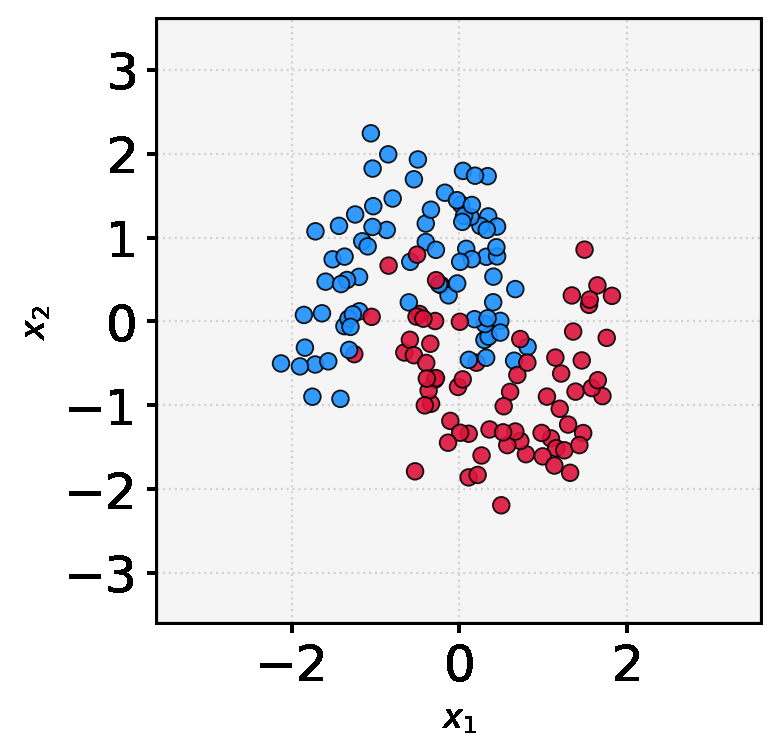

In [18]:
from plots.gifs import trajectory_gif

#the function trajectory_gif creates the evolution trajectories of the input data through the network
#the passing time corresponds to the depth of the network

for X_viz, y_viz in dataloader_viz:
    trajectory_gif(anode, X_viz, y_viz, timesteps=num_steps, filename = 'trajectory.gif')
    break

#Display of the generated gif

from IPython.display import Image
Image(filename="trajectory.gif", retina = True)

In [19]:
from plots.gifs import trajectory_gif

#the function trajectory_gif creates the evolution trajectories of the input data through the network
#the passing time corresponds to the depth of the network

for X_viz, y_viz in dataloader_viz:
    trajectory_gif(rnode, X_viz, y_viz, timesteps=num_steps, filename = 'trajectory_db.gif')
    break

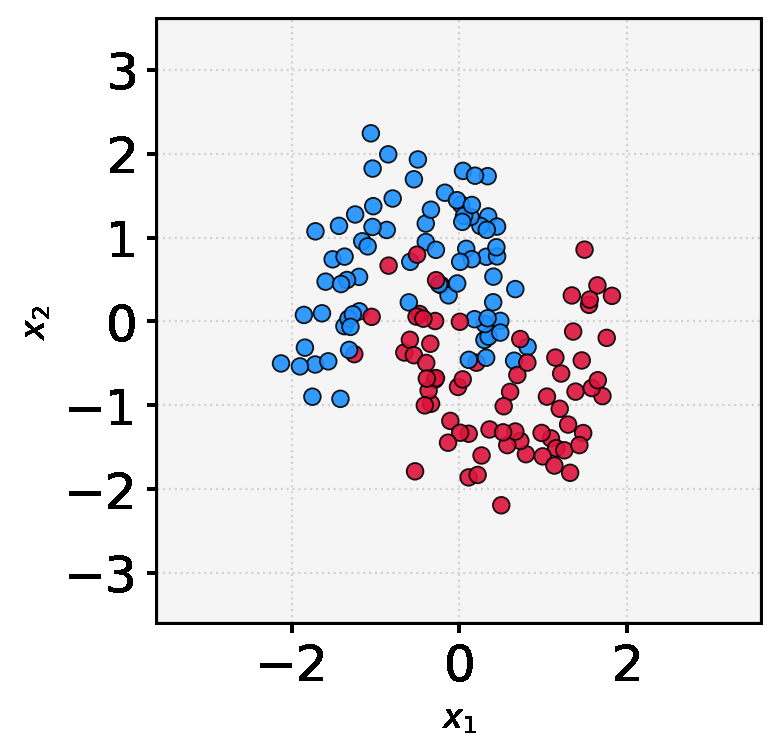

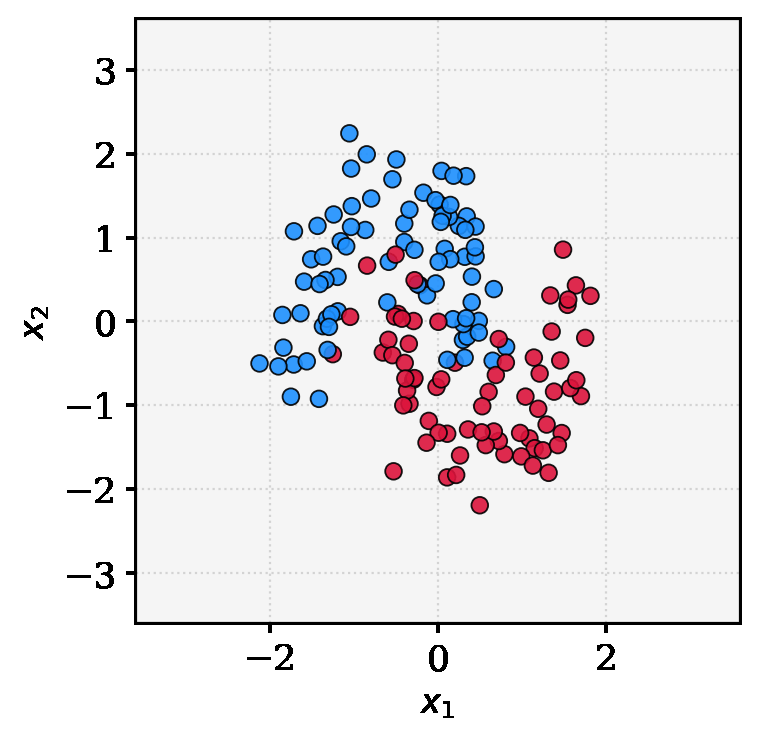

In [20]:
#Display of the generated gif

from IPython.display import Image
traj = Image(filename="trajectory.gif", retina = True)
rtraj = Image(filename="trajectory_db.gif", retina = True)
display(traj, rtraj)


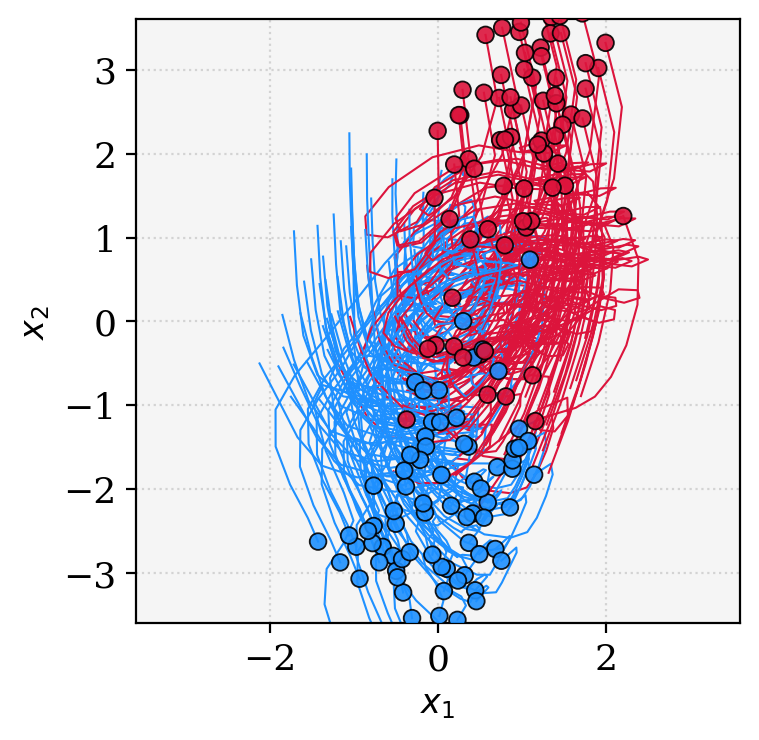

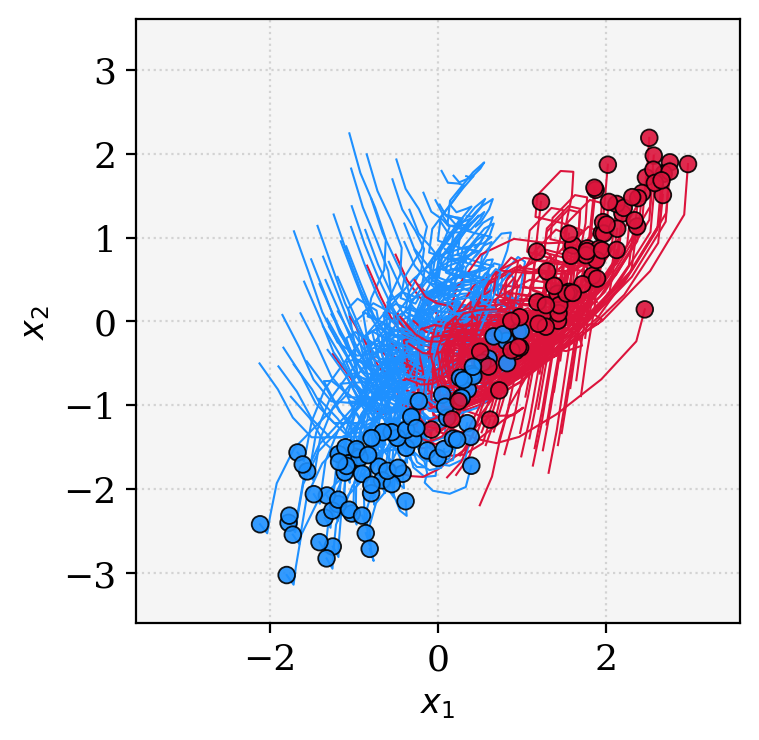

In [21]:
from IPython.display import Image
traj = Image(filename="trajectory19.png", retina = True)
rtraj = Image(filename="trajectory_db19.png", retina = True)
display(traj, rtraj)

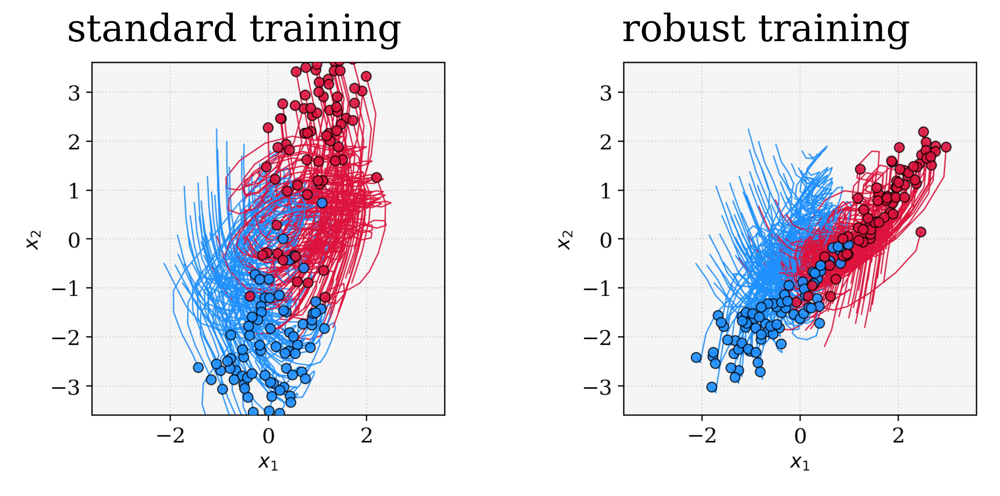

In [22]:
comparison_plot('trajectory19.png', 'standard training', 'trajectory_db19.png', 'robust training', 'traj_comp.png', show = True)
